In [1]:
# from google.colab import drive
# drive.mount('/content/gdrive')
# %cd /content/gdrive/My\ Drive/masters

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import os
import logging as log
from time import strftime
from copy import deepcopy
from torch import nn, optim
import torch.nn.functional as F
from utils.data_processing import *
from logger.logger import setup_logging
from utils.configs import BaseConf
from utils.metrics import best_threshold
from utils.utils import write_json, Timer
from dataloaders.grid_loader import GridDataLoaders
from datasets.grid_dataset import GridDataGroup
from utils.metrics import PRCurvePlotter, ROCCurvePlotter, LossPlotter, best_threshold, get_y_pred, \
                                get_y_pred_by_thresholds, best_thresholds
from sklearn.metrics import accuracy_score, average_precision_score, roc_auc_score
from models.model_result import ModelResult, ModelMetrics
from trainers.generic_trainer import train_model
from utils.plots import im
from utils.utils import pshape, get_data_sub_paths, by_ref
from models.model_result import save_metrics,save_results, compare_models, compare_all_models, get_metrics_table, \
                            get_models_metrics, get_models_results
from models.st_resnet_models import STResNet, STResNetExtra
from models.st_resnet_models import train_epoch_for_st_res_net, train_epoch_for_st_res_net_extra
from models.st_resnet_models import evaluate_st_res_net, evaluate_st_res_net_extra
import pandas as pd
from pprint import pprint
from torch.optim import lr_scheduler
pd.set_option('display.max_columns', None)

In [2]:
torch.cuda.is_available(), torch.cuda.is_initialized()

(False, False)

In [3]:
data_sub_paths = get_data_sub_paths()
pprint(sorted(data_sub_paths))

['T12H-X850M-Y880M_2013-01-01_2017-01-01',
 'T1H-X1700M-Y1760M_2013-01-01_2017-01-01',
 'T1H-X3400M-Y3520M_2014-01-01_2016-01-01_#2a4',
 'T24H-X1275M-Y1320M_2012-01-01_2019-01-01',
 'T24H-X1700M-Y1760M_2012-01-01_2019-01-01',
 'T24H-X255M-Y220M_2012-01-01_2019-01-01_#c97',
 'T24H-X255M-Y220M_2012-01-01_2019-01-01_#d97',
 'T24H-X255M-Y220M_2013-01-01_2017-01-01',
 'T24H-X255M-Y220M_2014-01-01_2019-01-01_#b29',
 'T24H-X425M-Y440M_2012-01-01_2019-01-01',
 'T24H-X425M-Y440M_2013-01-01_2017-01-01',
 'T24H-X850M-Y880M_2012-01-01_2019-01-01',
 'T24H-X850M-Y880M_2013-01-01_2017-01-01',
 'T24H-X850M-Y880M_2014-01-01_2019-01-01_#1a0',
 'T24H-X850M-Y880M_2014-01-01_2019-01-01_#3a0',
 'T24H-X85M-Y110M_2013-01-01_2017-01-01',
 'T3H-X850M-Y880M_2013-01-01_2017-01-01',
 'T6H-X850M-Y880M_2013-01-01_2017-01-01']


In [4]:
data_sub_path = by_ref("c97")[0]
print(f"using: {data_sub_path}")

using: T24H-X255M-Y220M_2012-01-01_2019-01-01_#c97


## Load data

In [5]:
USE_EXTRA = False # todo move extra model to own notebook

conf = BaseConf()

if USE_EXTRA:
    conf.model_name = "ST-RESNET-Extra"  # needs to be created
else:     
    conf.model_name = "ST-RESNET"  # needs to be created

conf.data_path = f"./data/processed/{data_sub_path}/"

if not os.path.exists(conf.data_path):
    raise Exception(f"Directory ({conf.data_path}) needs to exist.")

conf.model_path =  f"{conf.data_path}models/{conf.model_name}/"
os.makedirs(conf.data_path, exist_ok=True)
os.makedirs(conf.model_path, exist_ok=True)

# logging config is set globally thus we only need to call this in this file
# imported function logs will follow the configuration
setup_logging(save_dir=conf.model_path, log_config='./logger/standard_logger_config.json', default_level=log.INFO)
log.info("=====================================BEGIN=====================================")

info = deepcopy(conf.__dict__)
info["start_time"] = strftime("%Y-%m-%dT%H:%M:%S")

# DATA LOADER SETUP
np.random.seed(conf.seed)
use_cuda = False # torch.cuda.is_available()
torch.manual_seed(conf.seed)
if use_cuda:
    torch.cuda.manual_seed(conf.seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    

device = torch.device("cuda:0" if use_cuda else "cpu")
log.info(f"Device: {device}")
info["device"] = device.type
conf.device = device

2020-09-29T23:45:53 | root | INFO | =====================================BEGIN=====================================
2020-09-29T23:45:53 | root | INFO | Device: cpu


In [41]:
conf.batch_size = 128

# CRIME DATA
data_group = GridDataGroup(data_path=conf.data_path,
                           conf=conf)

loaders = GridDataLoaders(data_group=data_group,
                          conf=conf)

2020-09-29T23:57:06 | root | INFO | 	t_range: (2558,) 2012-01-01 00:00:00 -> 2019-01-01 00:00:00
2020-09-29T23:57:06 | root | INFO | 	target_len:	2515	(100.000%)
2020-09-29T23:57:06 | root | INFO | 	trn_val_size:	2150	(85.487%)
2020-09-29T23:57:06 | root | INFO | 	trn_size:	1613	(64.135%)
2020-09-29T23:57:06 | root | INFO | 	val_size:	537	(21.352%)
2020-09-29T23:57:06 | root | INFO | 	tst_size:	365 	(14.513%)


## Model setup

In [42]:
# SET THE HYPER PARAMETERS
conf.dropout = 0 # 0.2  # currently only being used in Kang and Kang models
conf.weight_decay = 1e-6 # [0, 1e-8, 1e-6, 1e-4, 1e-2]
conf.lr = 1e-3 # 1e-3

conf.checkpoint = "latest" # "best_val" # "best_trn_val" "best_trn_val" 
conf.resume = True
conf.freqstr = data_group.t_range.freqstr  
conf.max_epochs = 100
conf.early_stopping = False
conf.patience = 20

# SET LOSS FUNCTION
# size averaged - so more epochs or larger lr for smaller batches
loss_function = nn.MSELoss()  

# SETUP MODEL
dataset = loaders.train_loader.dataset
_, _, h_size, w_size = dataset.crimes.shape
_, n_ext_features = dataset.time_vectors.shape


# todo setup - hyper-optimiser
conf.n_layers = 5 # 12   # number of res-unit layers
conf.n_channels = 3 # 5 # inner channel size of the res-units 

if USE_EXTRA:
    train_epoch_fn = train_epoch_for_st_res_net_extra
    evaluate_fn = evaluate_st_res_net_extra
    model = STResNetExtra(n_layers=conf.n_layers,
                          n_channels=conf.n_channels,
                          y_size=h_size,
                          x_size=w_size,

                          lc=dataset.n_steps_c,
                          lp=dataset.n_steps_p,
                          lq=dataset.n_steps_q,

                          n_ext_features=n_ext_features,
                          n_demog_features=37,
                          n_demog_channels=10,
                          n_demog_layers=3,

                          n_gsv_features=512,
                          n_gsv_channels=10,
                          n_gsv_layers=3)
else:
    train_epoch_fn = train_epoch_for_st_res_net
    evaluate_fn = evaluate_st_res_net
    model = STResNet(n_layers=conf.n_layers,
                     n_channels=conf.n_channels,
                     y_size=h_size,
                     x_size=w_size,

                     lc=dataset.n_steps_c,
                     lp=dataset.n_steps_p,
                     lq=dataset.n_steps_q,

                     n_ext_features=n_ext_features)    
    
# todo implement model_arch for res-net
model.to(conf.device)

# SETUP OPTIMISER
parameters = model.parameters()
# todo (optional): setup model parameters dynamically 

optimiser = optim.Adam(params=parameters, lr=conf.lr, weight_decay=conf.weight_decay, amsgrad=False)
# optimiser = optim.SGD(params=parameters, lr=conf.lr)
scheduler = None
# scheduler = lr_scheduler.CosineAnnealingLR(optimizer=optimiser, T_max=10)#conf.max_epochs//5)
# scheduler = lr_scheduler.ReduceLROnPlateau(optimiser, mode='min', factor=0.1, patience=10,
#                                            threshold=0.0001, threshold_mode='rel', cooldown=0,
#                                            min_lr=0, eps=1e-08, verbose=False)

if conf.resume:
    try:
        # resume from previous check point or resume from best validaton score checkpoint
        # load model state
        model_state_dict = torch.load(f"{conf.model_path}model_{conf.checkpoint}.pth",
                                      map_location=conf.device.type)
        model.load_state_dict(model_state_dict)
        
        # load optimiser state
        optimiser_state_dict = torch.load(f"{conf.model_path}optimiser_{conf.checkpoint}.pth",
                                          map_location=conf.device.type)
        optimiser.load_state_dict(optimiser_state_dict) 

        # new optimiser hyper-parameters
        optimiser.param_groups[0]['lr'] = conf.lr
        optimiser.param_groups[0]['weight_decay'] = conf.weight_decay

    except Exception as e:
        log.error(f"Nothing to resume from, training from scratch \n\t-> {e}")


## Training loop

2020-09-29T23:57:10 | root | INFO | lr: 		0.001
2020-09-29T23:57:10 | root | INFO | weight_decay: 	1e-06
2020-09-29T23:57:10 | root | INFO | 
 ====================== Training ST-RESNET ====================== 

2020-09-29T23:57:10 | root | INFO | 
 ====================== Config Values ====================== 
{'batch_size': 128,
 'checkpoint': 'latest',
 'data_path': './data/processed/T24H-X255M-Y220M_2012-01-01_2019-01-01_#c97/',
 'device': device(type='cpu'),
 'dropout': 0,
 'early_stopping': False,
 'flatten_grid': True,
 'freqstr': '24H',
 'lr': 0.001,
 'max_epochs': 100,
 'model_name': 'ST-RESNET',
 'model_path': './data/processed/T24H-X255M-Y220M_2012-01-01_2019-01-01_#c97/models/ST-RESNET/',
 'n_channels': 3,
 'n_layers': 5,
 'n_steps_c': 3,
 'n_steps_p': 3,
 'n_steps_q': 3,
 'num_workers': 6,
 'pad_width': 0,
 'patience': 20,
 'resume': True,
 'seed': 3,
 'seq_len': 1,
 'shaper_threshold': 0,
 'shaper_top_k': -1,
 'shuffle': True,
 'sub_sample_test_set': 0,
 'sub_sample_train_set

2020-09-29T23:57:25 | root | INFO | 	Loss (Trn Val Dif): 	0.00039793

2020-09-29T23:57:25 | root | INFO | Epoch: 0014/0100
2020-09-29T23:57:26 | root | INFO | 	Loss (Trn): 		0.00190754
2020-09-29T23:57:26 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:26 | root | INFO | 	Loss (Val): 		0.00229226
2020-09-29T23:57:26 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:26 | root | INFO | 	Loss (Trn Val): 	0.00419979
2020-09-29T23:57:26 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:57:26 | root | INFO | 	Loss (Trn Val Dif): 	0.00038472

2020-09-29T23:57:26 | root | INFO | Epoch: 0015/0100
2020-09-29T23:57:27 | root | INFO | 	Loss (Trn): 		0.00190560
2020-09-29T23:57:27 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:27 | root | INFO | 	Loss (Val): 		0.00230144
2020-09-29T23:57:27 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:27 | root | INFO | 	Loss (Trn Val): 	0.00420704
2020-09-29T23:57:27 | root | INFO | 	Loss 

2020-09-29T23:57:41 | root | INFO | 	Loss (Trn Val Dif): 	0.00043574

2020-09-29T23:57:41 | root | INFO | Epoch: 0030/0100
2020-09-29T23:57:42 | root | INFO | 	Loss (Trn): 		0.00190940
2020-09-29T23:57:42 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:42 | root | INFO | 	Loss (Val): 		0.00229928
2020-09-29T23:57:42 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:42 | root | INFO | 	Loss (Trn Val): 	0.00420868
2020-09-29T23:57:42 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:57:42 | root | INFO | 	Loss (Trn Val Dif): 	0.00038988

2020-09-29T23:57:42 | root | INFO | Epoch: 0031/0100
2020-09-29T23:57:43 | root | INFO | 	Loss (Trn): 		0.00190560
2020-09-29T23:57:43 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:43 | root | INFO | 	Loss (Val): 		0.00231415
2020-09-29T23:57:43 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:43 | root | INFO | 	Loss (Trn Val): 	0.00421975
2020-09-29T23:57:43 | root | INFO | 	Loss 

2020-09-29T23:57:57 | root | INFO | 	Loss (Trn Val Dif): 	0.00038875

2020-09-29T23:57:57 | root | INFO | Epoch: 0046/0100
2020-09-29T23:57:58 | root | INFO | 	Loss (Trn): 		0.00190498
2020-09-29T23:57:58 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:58 | root | INFO | 	Loss (Val): 		0.00231907
2020-09-29T23:57:58 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:58 | root | INFO | 	Loss (Trn Val): 	0.00422405
2020-09-29T23:57:58 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:57:58 | root | INFO | 	Loss (Trn Val Dif): 	0.00041409

2020-09-29T23:57:58 | root | INFO | Epoch: 0047/0100
2020-09-29T23:57:59 | root | INFO | 	Loss (Trn): 		0.00190442
2020-09-29T23:57:59 | root | INFO | 	Loss (Best Trn): 	0.00190325
2020-09-29T23:57:59 | root | INFO | 	Loss (Val): 		0.00231906
2020-09-29T23:57:59 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:57:59 | root | INFO | 	Loss (Trn Val): 	0.00422348
2020-09-29T23:57:59 | root | INFO | 	Loss 

2020-09-29T23:58:14 | root | INFO | 	Loss (Trn Val Dif): 	0.00043982

2020-09-29T23:58:14 | root | INFO | Epoch: 0062/0100
2020-09-29T23:58:15 | root | INFO | 	Loss (Trn): 		0.00190519
2020-09-29T23:58:15 | root | INFO | 	Loss (Best Trn): 	0.00189971
2020-09-29T23:58:15 | root | INFO | 	Loss (Val): 		0.00230357
2020-09-29T23:58:15 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:15 | root | INFO | 	Loss (Trn Val): 	0.00420876
2020-09-29T23:58:15 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:58:15 | root | INFO | 	Loss (Trn Val Dif): 	0.00039838

2020-09-29T23:58:16 | root | INFO | Epoch: 0063/0100
2020-09-29T23:58:17 | root | INFO | 	Loss (Trn): 		0.00190590
2020-09-29T23:58:17 | root | INFO | 	Loss (Best Trn): 	0.00189971
2020-09-29T23:58:17 | root | INFO | 	Loss (Val): 		0.00231382
2020-09-29T23:58:17 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:17 | root | INFO | 	Loss (Trn Val): 	0.00421972
2020-09-29T23:58:17 | root | INFO | 	Loss 

2020-09-29T23:58:31 | root | INFO | 	Loss (Trn Val Dif): 	0.00038518

2020-09-29T23:58:31 | root | INFO | Epoch: 0078/0100
2020-09-29T23:58:32 | root | INFO | 	Loss (Trn): 		0.00190001
2020-09-29T23:58:32 | root | INFO | 	Loss (Best Trn): 	0.00189938
2020-09-29T23:58:32 | root | INFO | 	Loss (Val): 		0.00231958
2020-09-29T23:58:32 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:32 | root | INFO | 	Loss (Trn Val): 	0.00421960
2020-09-29T23:58:32 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:58:32 | root | INFO | 	Loss (Trn Val Dif): 	0.00041957

2020-09-29T23:58:32 | root | INFO | Epoch: 0079/0100
2020-09-29T23:58:33 | root | INFO | 	Loss (Trn): 		0.00190306
2020-09-29T23:58:33 | root | INFO | 	Loss (Best Trn): 	0.00189938
2020-09-29T23:58:33 | root | INFO | 	Loss (Val): 		0.00228759
2020-09-29T23:58:33 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:33 | root | INFO | 	Loss (Trn Val): 	0.00419066
2020-09-29T23:58:33 | root | INFO | 	Loss 

2020-09-29T23:58:49 | root | INFO | 	Loss (Trn Val Dif): 	0.00045049

2020-09-29T23:58:50 | root | INFO | Epoch: 0094/0100
2020-09-29T23:58:50 | root | INFO | 	Loss (Trn): 		0.00189996
2020-09-29T23:58:50 | root | INFO | 	Loss (Best Trn): 	0.00189821
2020-09-29T23:58:50 | root | INFO | 	Loss (Val): 		0.00230659
2020-09-29T23:58:50 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:50 | root | INFO | 	Loss (Trn Val): 	0.00420655
2020-09-29T23:58:50 | root | INFO | 	Loss (Best Trn Val): 	0.00416521
2020-09-29T23:58:50 | root | INFO | 	Loss (Trn Val Dif): 	0.00040663

2020-09-29T23:58:51 | root | INFO | Epoch: 0095/0100
2020-09-29T23:58:52 | root | INFO | 	Loss (Trn): 		0.00189683
2020-09-29T23:58:52 | root | INFO | 	Loss (Best Trn): 	0.00189683
2020-09-29T23:58:52 | root | INFO | 	Loss (Val): 		0.00230891
2020-09-29T23:58:52 | root | INFO | 	Loss (Best Val): 	0.00217151
2020-09-29T23:58:52 | root | INFO | 	Loss (Trn Val): 	0.00420574
2020-09-29T23:58:52 | root | INFO | 	Loss 

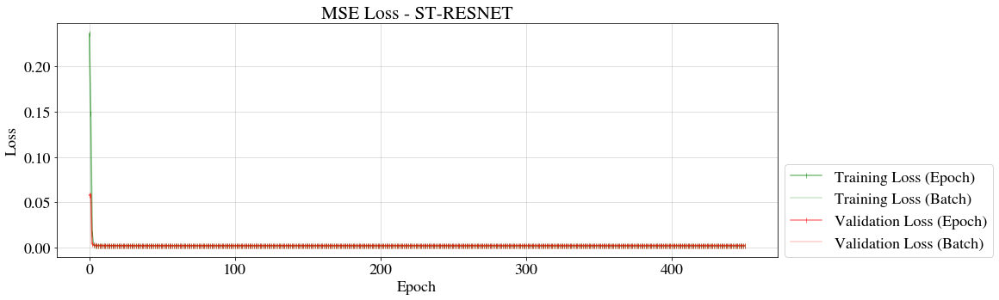

In [43]:
log.info(f"lr: \t\t{optimiser.param_groups[0]['lr']}")
log.info(f"weight_decay: \t{optimiser.param_groups[0]['weight_decay']}")
trn_epoch_losses, val_epoch_losses, stopped_early = train_model(
    model=model,
    optimiser=optimiser,
    loaders=loaders,
    train_epoch_fn=train_epoch_fn,
    loss_fn=loss_function,
    conf=conf,
    scheduler=scheduler,
)    

print(f"stopped_early: {stopped_early}") # use the current epoch instead
# if stopped_early -> continue with best_model - new hyper-parameters -> no n 

In [44]:
print(f"best validation: {np.min(val_epoch_losses):.6f} @ epoch: {np.argmin(val_epoch_losses)}")

trn_val_epoch_losses = np.array(trn_epoch_losses)+np.array(val_epoch_losses)

print(f"best train+valid loss: {np.min(trn_val_epoch_losses):.6f} @ epoch: {np.argmin(trn_val_epoch_losses)}")

best validation: 0.002172 @ epoch: 27
best train+valid loss: 0.004165 @ epoch: 359


In [45]:
# from utils.interactive import plot_interactive_epoch_losses
from utils.interactive import plot_interactive_epoch_losses

plot_interactive_epoch_losses(trn_epoch_losses, val_epoch_losses)

In [13]:
# over fitted data loss on training data: 0.00101265 (target for none overfitted data)

In [14]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

def plot_interactive_model_losses(conf):
    losses_zip = np.load(f"{conf.model_path}losses_{conf.checkpoint}.npz")
    
    trn_batch_losses = losses_zip['trn_batch_losses']
    val_batch_losses = losses_zip['val_batch_losses']
    trn_epoch_losses = losses_zip['trn_epoch_losses']
    val_epoch_losses = losses_zip['val_epoch_losses']


    fig = make_subplots(rows=3, cols=1)
    

    fig.add_trace(go.Scatter(y=trn_epoch_losses,name="Train Epoch Losses",mode='lines+markers'),row=1, col=1,)       
    fig.add_trace(go.Scatter(y=val_epoch_losses,name="Validation Epoch Losses",mode='lines+markers'),row=1, col=1,)                                   
    fig.add_trace(go.Scatter(y=[np.min(val_epoch_losses)],
                       x=[np.argmin(val_epoch_losses)],name="Best Validation Epoch Loss",mode='markers',
                       marker_symbol='x', marker_size=10),row=1, col=1,)

    fig.add_trace(go.Scatter(y=trn_batch_losses,name="Train Batch Losses",mode='lines+markers'),row=2, col=1,)
    fig.add_trace(go.Scatter(y=[np.min(trn_batch_losses)],
                       x=[np.argmin(trn_batch_losses)],name="Best Training Batch Loss",mode='markers',
                       marker_symbol='x', marker_size=10),row=2, col=1,)
    
    fig.add_trace(go.Scatter(y=val_batch_losses,name="Validation Batch Losses",mode='lines+markers'),row=3, col=1,)
    fig.add_trace(go.Scatter(y=[np.min(val_batch_losses)],
                       x=[np.argmin(val_batch_losses)],name="Best Validation Batch Loss",mode='markers',
                       marker_symbol='x', marker_size=10),row=3, col=1,)
    
    fig.update_layout(height=900,
                      title="Train and Validation Losses",
                      title_x=0.5)
    return fig

In [15]:
# plot_interactive_model_losses(conf)

## Evaluation

In [37]:
# Load latest or best validation model
# conf.checkpoint = "latest"
# conf.checkpoint = "best_val"
conf.checkpoint = "best_trn"
# conf.checkpoint = "best_trn_val"

log.info(f"Loading model from checkpoint ({conf.checkpoint}) for evaluation")

# resume from previous check point or resume from best validaton score checkpoint
# load model state
log.info(f"loading model from {conf.model_path}")
model_state_dict = torch.load(f"{conf.model_path}model_{conf.checkpoint}.pth",
                                map_location=conf.device.type)
model.load_state_dict(model_state_dict)

2020-09-29T23:56:24 | root | INFO | Loading model from checkpoint (best_trn) for evaluation
2020-09-29T23:56:24 | root | INFO | loading model from ./data/processed/T24H-X255M-Y220M_2012-01-01_2019-01-01_#c97/models/ST-RESNET/


<All keys matched successfully>

In [38]:
from models.model_result import save_metrics,save_results

In [39]:
trn_y_counts, trn_y_true, trn_probas_pred, trn_t_range = evaluate_fn(model=model,
                                                                     batch_loader=loaders.train_loader,
                                                                     conf=conf) 
thresh = best_threshold(trn_y_true, trn_probas_pred) 

tst_y_counts, tst_y_true, tst_probas_pred, tst_t_range = evaluate_fn(model=model,
                                                                     batch_loader=loaders.test_loader,
                                                                     conf=conf)

# tst_y_true = np.expand_dims(tst_y_true, axis=1)
# tst_probas_pred = np.expand_dims(tst_probas_pred, axis=1) 

tst_y_true = data_group.shaper.squeeze(tst_y_true)
tst_probas_pred = data_group.shaper.squeeze(tst_probas_pred)

tst_y_pred = get_y_pred(thresh, tst_probas_pred)
save_metrics(y_true=tst_y_true,
             y_pred=tst_y_pred,
             probas_pred=tst_probas_pred,
             t_range=tst_t_range,
             shaper=data_group.shaper,                
             conf=conf)

save_results(y_true=tst_y_true,
             y_pred=tst_y_pred,
             probas_pred=tst_probas_pred,
             t_range=tst_t_range,
             shaper=data_group.shaper,                
             conf=conf)

2020-09-29T23:56:26 | root | INFO | f1_score: 0.4402671283700223 at index 360556, new threshold 0.041680119931697845
2020-09-29T23:56:27 | root | INFO | 
            MODEL METRICS (Over All Samples)
                Model Name: ST-RESNET
                    MAE:                0.12551
                    RMSE:               0.32530
                    ROC AUC:            0.81684                
                    Average Precision:  0.42399
                    Precision:          0.41426
                    Recall:             0.45665
                    Accuracy:           0.85923
                    PAI:                3.49907
                    MCC:                0.35480          
            
2020-09-29T23:56:29 | root | INFO | 
            MODEL METRICS (Over All Samples)
                Model Name: ST-RESNET
                    MAE:                0.14077
                    RMSE:               0.37519
                    ROC AUC:            0.68497                
            

2020-09-29T23:56:30 | root | INFO | 
                          RMSE       MAE   ROC AUC  Avg. Precision  Precision  \
Model Name                                                                      
Ind-Hawkes Model      0.297465  0.147201  0.822260        0.439749   0.409403   
Historic Average      0.328725  0.125658  0.822092        0.438345   0.403607   
Global Average        0.328981  0.125609  0.821002        0.431617   0.406593   
ST-RESNET             0.325304  0.125513  0.816840        0.423990   0.414259   
Previous Time Step    0.328907  0.125817  0.613490        0.206161   0.314258   
Hawkes General Model  0.343690  0.121538  0.500000        0.118926   0.118926   

                        Recall  F1 Score  Accuracy       MCC       PAI  
Model Name                                                              
Ind-Hawkes Model      0.490037  0.446106  0.855281  0.365586  3.442497  
Historic Average      0.507226  0.449522  0.852260  0.368659  3.393760  
Global Average        

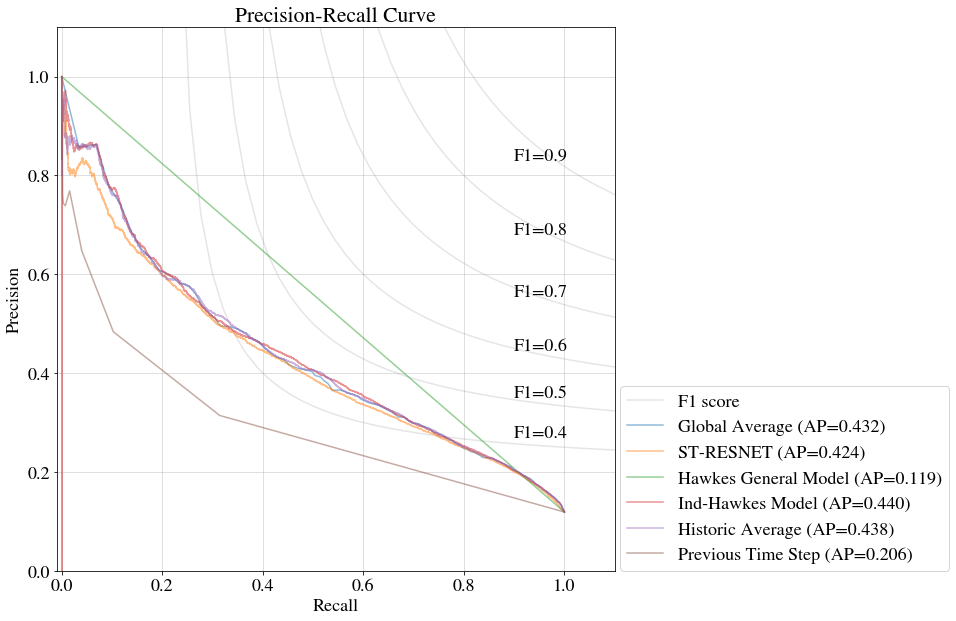

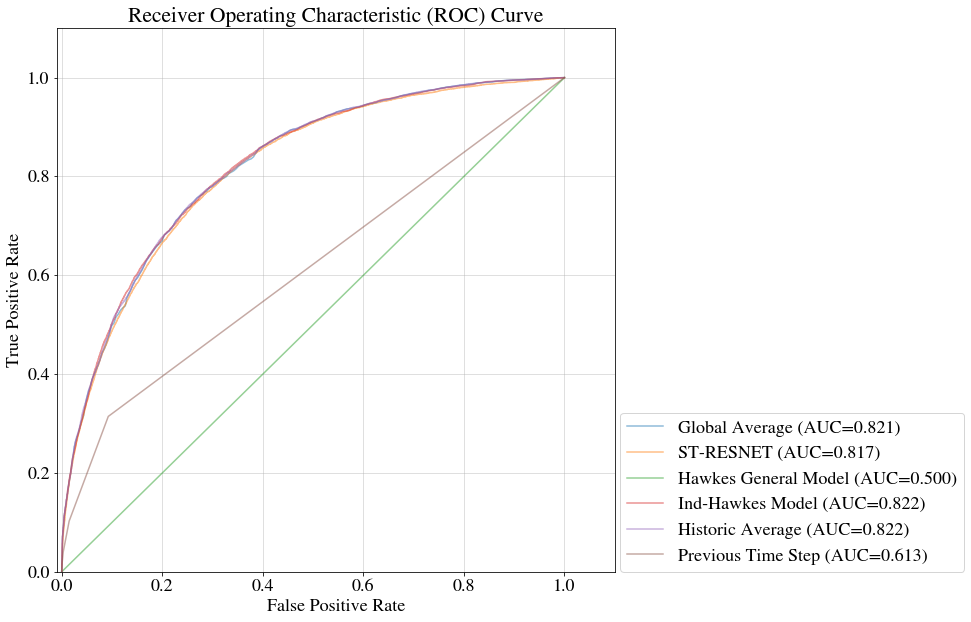

,RMSE,MAE,ROC AUC,Avg. Precision,Precision,Recall,F1 Score,Accuracy,MCC,PAI
Model Name,,,,,,,,,,
Ind-Hawkes Model,0.297465,0.147201,0.822260,0.439749,0.409403,0.490037,0.446106,0.855281,0.365586,3.442497
Historic Average,0.328725,0.125658,0.822092,0.438345,0.403607,0.507226,0.449522,0.852260,0.368659,3.393760
Global Average,0.328981,0.125609,0.821002,0.431617,0.406593,0.486096,0.442804,0.854513,0.361799,3.418875
ST-RESNET,0.325304,0.125513,0.816840,0.423990,0.414259,0.456655,0.434425,0.859229,0.354801,3.499072
Previous Time Step,0.328907,0.125817,0.613490,0.206161,0.314258,0.314430,0.314344,0.836870,0.221766,2.642461
Hawkes General Model,0.343690,0.121538,0.500000,0.118926,0.118926,1.000000,0.212572,0.118926,0.000000,1.000000


In [40]:
compare_all_models(conf.data_path)

In [16]:
from utils.interactive import plot_interactive_roc, plot_interactive_pr
plot_interactive_pr(conf.data_path,beta=1).show()
plot_interactive_roc(conf.data_path).show()

In [17]:
models_metrics = get_models_metrics(data_path=conf.data_path)
get_metrics_table(models_metrics)

,RMSE,MAE,ROC AUC,Avg. Precision,Precision,Recall,F1 Score,Accuracy,MCC,PAI
Model Name,,,,,,,,,,
Ind-Hawkes Model,0.297465,0.147201,0.822260,0.439749,0.409403,0.490037,0.446106,0.855281,0.365586,3.442497
Historic Average,0.328725,0.125658,0.822092,0.438345,0.403607,0.507226,0.449522,0.852260,0.368659,3.393760
ST-RESNET,0.326139,0.124988,0.819776,0.433910,0.390167,0.499453,0.438097,0.848318,0.355535,3.295576
Global Average,0.328981,0.125609,0.821002,0.431617,0.406593,0.486096,0.442804,0.854513,0.361799,3.418875
Previous Time Step,0.328907,0.125817,0.613490,0.206161,0.314258,0.314430,0.314344,0.836870,0.221766,2.642461
Hawkes General Model,0.343690,0.121538,0.500000,0.118926,0.118926,1.000000,0.212572,0.118926,0.000000,1.000000


### View Training Predictions 

In [40]:
[i.shape for i in [trn_y_counts, trn_y_true, trn_probas_pred, trn_t_range]]

[(1613, 1, 23, 11), (1613, 1, 23, 11), (1613, 1, 23, 11), (1613,)]

In [41]:
trn_y_counts, trn_y_true, trn_probas_pred, trn_t_range = evaluate_fn(model=model,
                                                                     batch_loader=loaders.train_loader,
                                                                     conf=conf) 

from utils.interactive import InteractiveHeatmaps

InteractiveHeatmaps(
    date_range=trn_t_range, 
    Counts=trn_y_counts[:,0], 
    Hotspots=trn_y_true[:,0],
    Probabilities=trn_probas_pred[:,0],
).app

### View Testing Predictions

In [42]:
from utils.interactive import InteractiveHeatmaps

tst_y_counts, tst_y_true, tst_probas_pred, tst_t_range = evaluate_fn(model=model,
                                                                     batch_loader=loaders.test_loader,
                                                                     conf=conf)

InteractiveHeatmaps(
    date_range=tst_t_range, 
    Counts=tst_y_counts[:,0], 
    Hotspots=tst_y_true[:,0],
    Probabilities=tst_probas_pred[:,0],
).app

In [50]:
models_results = get_models_results(data_path=conf.data_path)

In [51]:
m = models_results[0].probas_pred

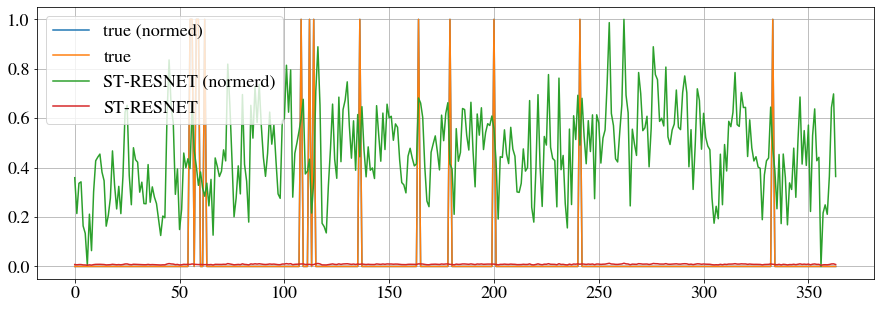

In [52]:
m = models_results[0]

def norm(x):
#     return x
    x = x - np.min(x)
    x = x / np.max(x)
    return x

i = 0
lim = 400
for m in models_results:
    plt.figure(figsize=(15,5))

    y_true = m.y_true[:lim,0,i]#.sum(1)
    plt.plot(norm(y_true),label='true (normed)')
    plt.plot(y_true,label='true')

    x0 = m.probas_pred[:lim,0,i]#.sum(1)
    plt.plot(norm(x0),label=f"{m.model_name} (normerd)")
    plt.plot(x0,label=m.model_name)

    plt.grid()
    plt.legend()
    plt.show()


----------------------------------------------------------------------------------------------------